# GoBi 2024/25 - Spatial2

**Supervisors:** Heinig, Träuble\
**Students:** Bui, Hansen, Hummel, Stein

In [1]:
import anndata as ad
import scanpy as sc
#import squidpy as sq
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import cell2location as c2l
import numpy as np
import os
import warnings
warnings.filterwarnings('ignore', category=UserWarning)
from dotenv import load_dotenv
load_dotenv()

True

#### Data import

In [2]:
adata_scatlas = ad.read_h5ad(os.environ.get('PATH_TO_SCATLAS'))
adata_visium = ad.read_h5ad(os.environ.get('PATH_TO_VISIUM'))

## 1. Data Overview

In [3]:
print("Number of cells before filtering:", adata_scatlas.n_obs)

Number of cells before filtering: 259721


Since some genes seem to have zero counts and the atlas should have been pre-processed, we remove those (agreed with Korbinian):

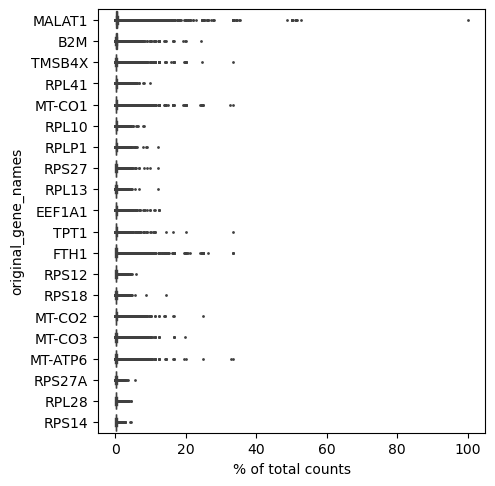

In [4]:
adata_scatlas.var_names = adata_scatlas.var["original_gene_names"]
sc.pp.filter_cells(adata_scatlas, min_counts=1)
sc.pl.highest_expr_genes(adata_scatlas, n_top=20)

In [5]:
print("Number of cells after filtering out zero counts:", adata_scatlas.n_obs)

Number of cells after filtering out zero counts: 259720


Text(0.5, 1.0, 'Distribution of Total Counts')

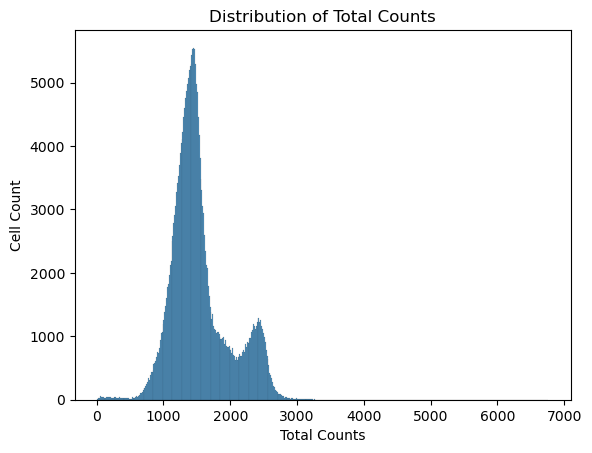

In [6]:
adata_scatlas.obs["total_counts"] = adata_scatlas.X.sum(axis=1)
sns.histplot(adata_scatlas.obs['total_counts'])
plt.xlabel('Total Counts')
plt.ylabel('Cell Count')
plt.title('Distribution of Total Counts')

To get sure, if the data was normalized before, we do the same plot just with the raw counts

Text(0.5, 1.0, 'Distribution of Raw Total Counts')

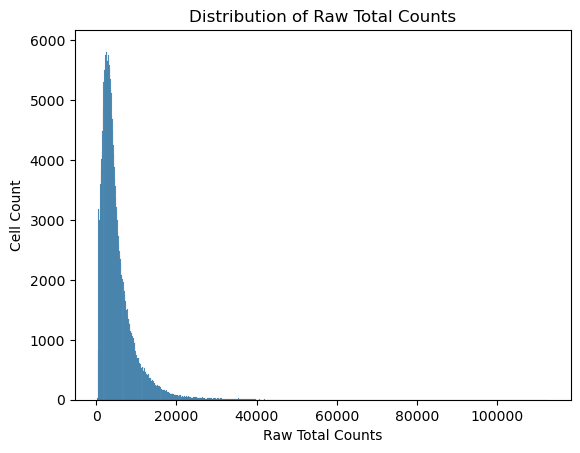

In [7]:
adata_scatlas.obs["total_counts_raw"] = adata_scatlas.raw.X.sum(axis=1)
sns.histplot(adata_scatlas.obs['total_counts_raw'])
plt.xlabel('Raw Total Counts')
plt.ylabel('Cell Count')
plt.title('Distribution of Raw Total Counts')

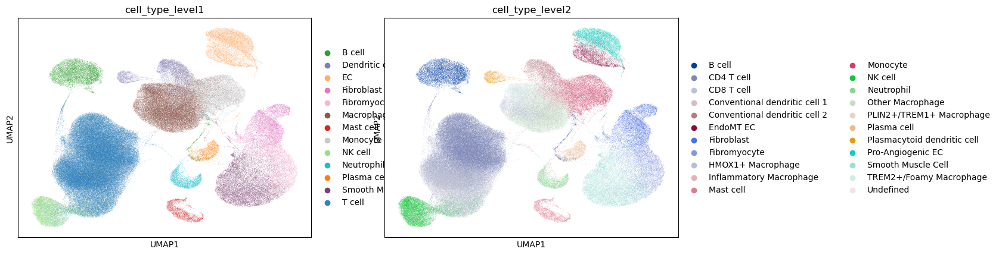

In [8]:
sc.pl.umap(adata_scatlas, color = ["cell_type_level1","cell_type_level2"])

## 2. Model Training on Atlas data

In [9]:
# Estimate some cut-off values for filtering
total_genes = adata_scatlas.shape[1]
print(f"Total number of genes: {total_genes}")

# Get the number of cells where each gene has non-zero expression
gene_cell_count = np.sum(adata_scatlas.X > 0, axis=0)

# Count the number of genes with more than 5 cell counts
genes_with_5_cells = np.sum(gene_cell_count > 5)
print(f"Number of genes with more than 5 cell counts: {genes_with_5_cells}")
print(f"Number of cells: {adata_scatlas.shape[0]}")

Total number of genes: 25840
Number of genes with more than 5 cell counts: 25662
Number of cells: 259720


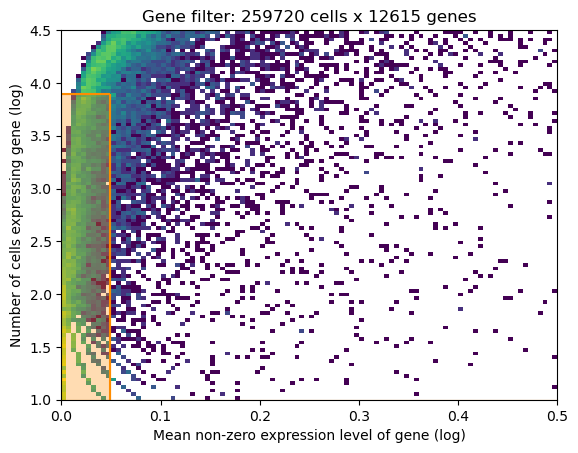

In [10]:
from cell2location.utils.filtering import filter_genes
adata_ref = adata_scatlas.copy()
adata_ref.X = adata_ref.raw.X
selected = filter_genes(adata_ref, cell_count_cutoff=1, cell_percentage_cutoff2=0.03, nonz_mean_cutoff=1.12)
adata_ref = adata_ref[:, selected].copy()

## 3. Import Model

In [11]:
# Load the model (node: it is the path to the folder containing model.pt, so do not include model.pt in your path)
model2wo = c2l.models.RegressionModel.load(os.environ.get('PATH_TO_ATLAS_MODEL2WO'), adata_ref)
adata_ref = model2wo.export_posterior(
    adata_ref, use_quantiles=True,
    add_to_varm=["q05","q50", "q95"],
    sample_kwargs={'batch_size': 2500}
)
# For the QC plot afterwards
adata_ref = model2wo.export_posterior(adata_ref, sample_kwargs={'num_samples': 1000, 'batch_size': 2500})

INFO     File /home/b/buit/atlas_model/model.pt already downloaded                                                 


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training:   0%|          | 0/77 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=1` reached.


Sampling local variables, batch:   0%|          | 0/104 [00:00<?, ?it/s]

Sampling global variables, sample:   0%|          | 0/999 [00:00<?, ?it/s]

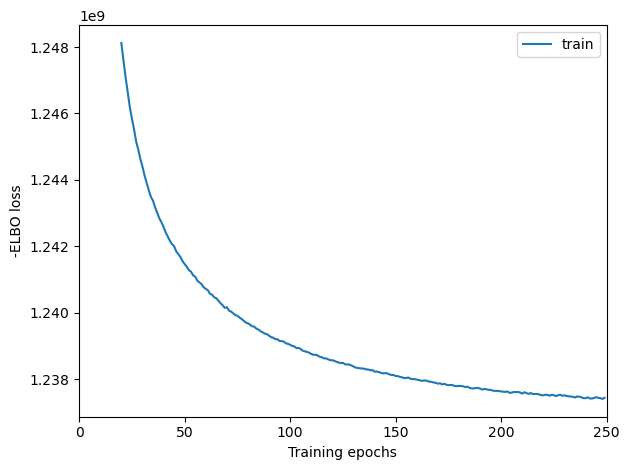

In [12]:
model2wo.plot_history(20)

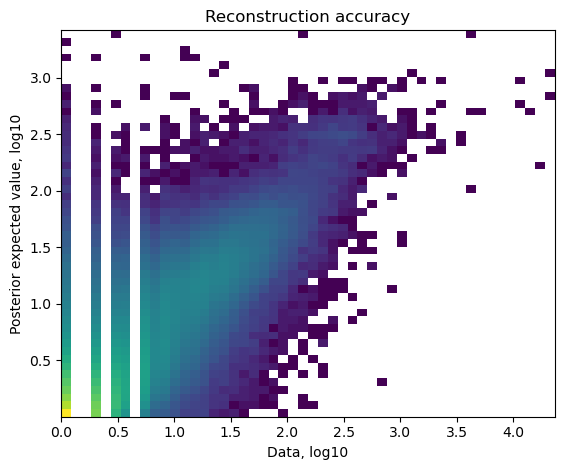

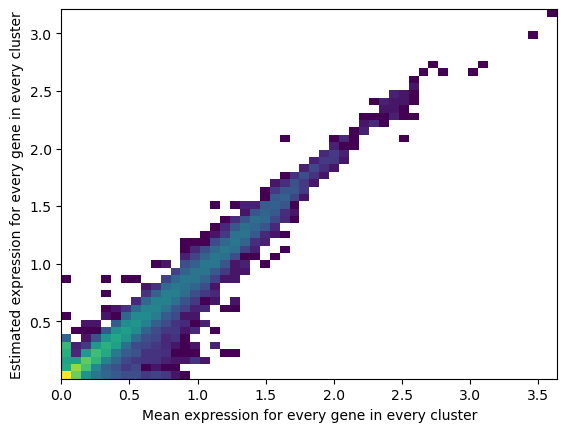

In [13]:
# Examine QC plot
model2wo.plot_QC()

In [14]:
# Extracting reference cell types signatures as a pd.DataFrame
if 'means_per_cluster_mu_fg' in adata_ref.varm.keys():
    inf_aver = adata_ref.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_ref.var[[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_ref.uns['mod']['factor_names']
inf_aver

,B cell,CD4 T cell,CD8 T cell,Conventional dendritic cell 1,Conventional dendritic cell 2,EndoMT EC,Fibroblast,Fibromyocyte,HMOX1+ Macrophage,Inflammatory Macrophage,...,NK cell,Neutrophil,Other Macrophage,PLIN2+/TREM1+ Macrophage,Plasma cell,Plasmacytoid dendritic cell,Pro-Angiogenic EC,Smooth Muscle Cell,TREM2+/Foamy Macrophage,Undefined
original_gene_names,,,,,,,,,,,,,,,,,,,,,
TSPAN6,0.000218,0.000827,0.000041,0.056380,0.000581,0.423629,0.116920,0.078944,0.002510,0.001115,...,0.000230,0.000391,0.000204,0.001310,0.004101,0.000774,0.128783,0.044370,0.001167,0.007331
TNMD,0.000090,0.000015,0.000021,0.005701,0.000277,0.000831,0.000120,0.000093,0.000237,0.000320,...,0.000127,0.000309,0.000040,0.000988,0.000569,0.001153,0.001662,0.000064,0.000151,0.153731
DPM1,0.059806,0.084241,0.073408,0.295888,0.281855,0.221249,0.236309,0.202394,0.157425,0.184376,...,0.073594,0.003791,0.146375,0.289705,0.138545,0.235034,0.182405,0.144282,0.334515,0.182499
SCYL3,0.010632,0.018028,0.011713,0.020075,0.022122,0.029316,0.028024,0.024143,0.029794,0.024637,...,0.015817,0.002690,0.027018,0.022798,0.013598,0.080436,0.029920,0.016119,0.034901,0.019255
FGR,0.008561,0.000457,0.017692,0.643634,0.907247,0.098938,0.005439,0.001219,0.278053,0.765213,...,0.208214,0.212727,0.194951,1.016008,0.009522,0.013966,0.057348,0.000506,0.890560,0.150557
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC253572.2,0.003180,0.000060,0.000055,0.032013,0.330808,0.000347,0.000154,0.000108,0.064128,0.232097,...,0.000275,0.000305,0.226488,0.280685,0.023290,0.324122,0.000156,0.000062,0.057223,0.044107
AC092803.4,0.000094,0.000038,0.000024,0.001587,0.014834,0.000177,0.000142,0.000263,0.010876,0.022146,...,0.000132,0.001062,0.013749,0.016776,0.000649,0.000761,0.000131,0.000100,0.005397,0.004268
AC093849.4,0.000142,0.000043,0.000039,0.002006,0.004047,0.002078,0.000268,0.000149,0.011471,0.010685,...,0.000258,0.000292,0.017872,0.004366,0.000630,0.000913,0.001448,0.000077,0.017498,0.005309


## 4. Cell type mapping

In [15]:
adata_visium.obs['sample']

spot_id
FW104302_AAACAAGTATCTCCCA-1    FW104302
FW104302_AAACACCAATAACTGC-1    FW104302
FW104302_AAACAGAGCGACTCCT-1    FW104302
FW104302_AAACAGCTTTCAGAAG-1    FW104302
FW104302_AAACAGGGTCTATATT-1    FW104302
                                 ...   
FW106022_TTGTCGTTCAGTTACC-1    FW106022
FW106022_TTGTGAGGCATGACGC-1    FW106022
FW106022_TTGTGGCCCTGACAGT-1    FW106022
FW106022_TTGTTCTAGATACGCT-1    FW106022
FW106022_TTGTTTCCATACAACT-1    FW106022
Name: sample, Length: 16593, dtype: category
Categories (12, object): ['FW104302', 'FW104306', 'FW104860', 'FW106005_v2', ..., 'FW106014', 'FW106016', 'FW106018', 'FW106022']

In [16]:
def select_slide(adata, s, s_col='sample'):
    r""" This function selects the data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param s_col: column in adata.obs listing experiment name for each location
    """

    slide = adata[adata.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide

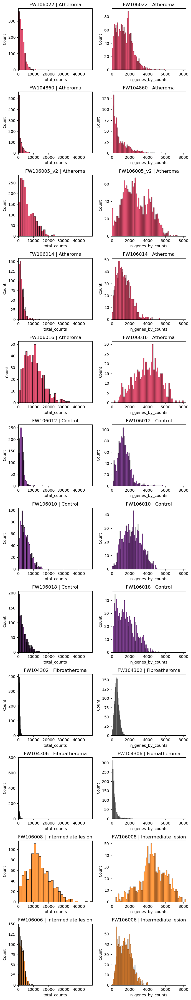

In [17]:
# Do manual sample mapping like in the paper
Sample_to_Disease = dict(
    FW104302="Fibroatheroma",
    FW104306="Fibroatheroma",
    FW104860="Atheroma",
    FW106005_v2="Atheroma",
    FW106006="Intermediate lesion",
    FW106008="Intermediate lesion",
    FW106010="Control",
    FW106012="Control",
    FW106014="Atheroma",
    FW106016="Atheroma",
    FW106018="Control",
    FW106022="Atheroma")
adata_visium.obs['Disease'] = (
    adata_visium.obs['sample'].map(Sample_to_Disease)
)
# Sort samples by disease group
sorted_samples = adata_visium.obs.sort_values(by='Disease')['sample'].unique()

# PLOT QC FOR EACH SAMPLE

fig, axs = plt.subplots(len(sorted_samples), 2, figsize=(7, len(sorted_samples)*3))

# Define color palette for disease categories
disease_palette = {'Control': '#52006A', 'Intermediate lesion': '#FF7600', 
                   'Atheroma': '#CD113B', 'Fibroatheroma': '#808080'}

for i, s in enumerate(sorted_samples):
    slide = select_slide(adata_visium, s)
    sample_value = adata_visium.obs.loc[adata_visium.obs['sample'] == s, 'sample'].unique()[0]
    disease_value = adata_visium.obs.loc[adata_visium.obs['sample'] == s, 'Disease'].unique()[0]
    header = f'{sample_value} | {disease_value}'

    # Get color for the disease category
    disease_color = disease_palette.get(disease_value, 'gray')

    # Plot the distribution of total_counts
    sns.histplot(slide.obs['total_counts'], kde=False, ax=axs[i, 0], color=disease_color, bins=30)
    axs[i, 0].set_xlim(0, adata_visium.obs['total_counts'].max())
    axs[i, 0].set_xlabel('total_counts')
    axs[i, 0].set_title(header)

    # Plot the distribution of n_genes_by_counts
    sns.histplot(slide.obs['n_genes_by_counts'], kde=False, ax=axs[i, 1], color=disease_color, bins=60)
    axs[i, 1].set_xlim(0, adata_visium.obs['n_genes_by_counts'].max())
    axs[i, 1].set_xlabel('n_genes_by_counts')
    axs[i, 1].set_title(header)

plt.tight_layout()
plt.show()


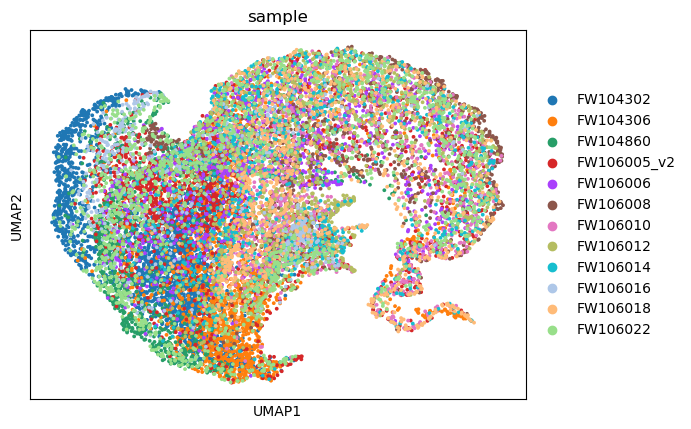

In [18]:
sc.pl.umap(adata_visium, color=['sample'], size=30,
               color_map = 'RdPu', ncols = 1, legend_fontsize=10)

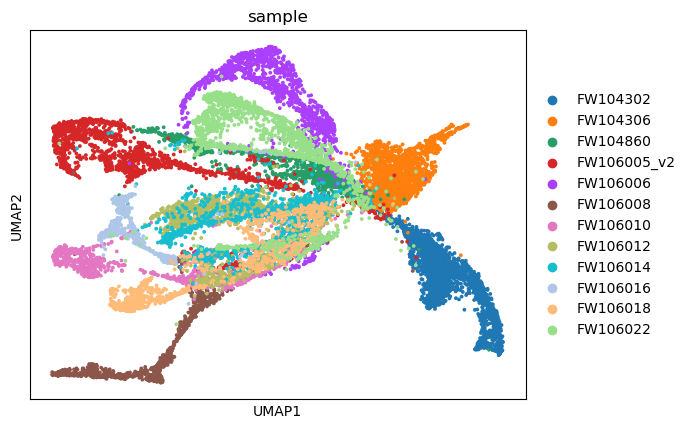

In [19]:
# Plot UMAP with log-transformed data

# Log-transform (log(data + 1))
adata_vis_plt = adata_visium.copy()
sc.pp.log1p(adata_vis_plt)

# Find highly variable genes within each sample
adata_vis_plt.var['highly_variable'] = False
for s in adata_vis_plt.obs['sample'].unique():
    adata_vis_plt_1 = adata_vis_plt[adata_vis_plt.obs['sample'] == s, :]
    sc.pp.highly_variable_genes(adata_vis_plt_1, n_top_genes=3000)  
    hvg_list = list(adata_vis_plt_1.var_names[adata_vis_plt_1.var['highly_variable']])
    adata_vis_plt.var.loc[hvg_list, 'highly_variable'] = True

# Scale the data
sc.pp.scale(adata_vis_plt, max_value=10)

# PCA, KNN construction, UMAP
sc.tl.pca(adata_vis_plt, svd_solver='arpack', n_comps=40, mask_var='highly_variable')  
sc.pp.neighbors(adata_vis_plt, n_neighbors=25, n_pcs=40, metric='cosine')
sc.tl.umap(adata_vis_plt, min_dist=0.3, spread=1)

# Plot UMAP
sc.pl.umap(adata_vis_plt, color=['sample'], size=30, color_map='RdPu', ncols=1, legend_fontsize=10)

In [20]:
adata_visium.var

,gene_ids,feature_types,genome,mt,n_cells_by_counts-FW104302,mean_counts-FW104302,log1p_mean_counts-FW104302,pct_dropout_by_counts-FW104302,total_counts-FW104302,log1p_total_counts-FW104302,...,log1p_mean_counts-FW106018,pct_dropout_by_counts-FW106018,total_counts-FW106018,log1p_total_counts-FW106018,n_cells_by_counts-FW106022,mean_counts-FW106022,log1p_mean_counts-FW106022,pct_dropout_by_counts-FW106022,total_counts-FW106022,log1p_total_counts-FW106022
A1CF,ENSG00000148584,Gene Expression,GRCh38,False,0,0.000000,0.000000,100.000000,0.0,0.000000,...,0.000000,100.000000,0.0,0.000000,1,0.000627,0.000627,99.937304,1.0,0.693147
A2M,ENSG00000175899,Gene Expression,GRCh38,False,739,0.340926,0.293360,73.282719,943.0,6.850126,...,1.470714,25.967413,3292.0,8.099554,1256,3.513480,1.507068,21.253918,5604.0,8.631414
AADAC,ENSG00000114771,Gene Expression,GRCh38,False,4,0.001808,0.001806,99.855387,5.0,1.791759,...,0.000000,100.000000,0.0,0.000000,2,0.001254,0.001253,99.874608,2.0,1.098612
AADACL2,ENSG00000197953,Gene Expression,GRCh38,False,2,0.000723,0.000723,99.927693,2.0,1.098612,...,0.000000,100.000000,0.0,0.000000,0,0.000000,0.000000,100.000000,0.0,0.000000
ABCA1,ENSG00000165029,Gene Expression,GRCh38,False,325,0.134490,0.126183,88.250181,372.0,5.921578,...,0.176022,83.401222,189.0,5.247024,452,0.480251,0.392212,71.661442,766.0,6.642487
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZSCAN4,ENSG00000180532,Gene Expression,GRCh38,False,3,0.001085,0.001084,99.891540,3.0,1.386294,...,0.001018,99.898167,1.0,0.693147,0,0.000000,0.000000,100.000000,0.0,0.000000
ZSWIM6,ENSG00000130449,Gene Expression,GRCh38,False,8,0.003254,0.003249,99.710774,9.0,2.302585,...,0.011139,98.879837,11.0,2.484907,21,0.013793,0.013699,98.683386,22.0,3.135494
ZW10,ENSG00000086827,Gene Expression,GRCh38,False,89,0.034346,0.033769,96.782357,95.0,4.564348,...,0.062181,93.991853,63.0,4.158883,88,0.057680,0.056078,94.482759,92.0,4.532599
ZWINT,ENSG00000122952,Gene Expression,GRCh38,False,27,0.010484,0.010430,99.023861,29.0,3.401197,...,0.006091,99.389002,6.0,1.945910,18,0.011912,0.011842,98.871473,19.0,2.995732


In [21]:
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_visium.var_names, inf_aver.index)
adata_visium = adata_visium[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

inf_aver

,B cell,CD4 T cell,CD8 T cell,Conventional dendritic cell 1,Conventional dendritic cell 2,EndoMT EC,Fibroblast,Fibromyocyte,HMOX1+ Macrophage,Inflammatory Macrophage,...,NK cell,Neutrophil,Other Macrophage,PLIN2+/TREM1+ Macrophage,Plasma cell,Plasmacytoid dendritic cell,Pro-Angiogenic EC,Smooth Muscle Cell,TREM2+/Foamy Macrophage,Undefined
original_gene_names,,,,,,,,,,,,,,,,,,,,,
A2M,0.000447,0.002224,0.004406,0.042904,0.401545,1.256863,2.685632,6.288700,3.000575,0.536463,...,0.003747,0.000398,1.768755,0.746118,0.054341,0.008556,5.955625,4.559841,1.265634,0.117709
AADAC,0.656230,0.097163,0.219042,0.947232,0.843229,0.751794,0.661662,0.532700,0.676967,0.761837,...,0.573466,0.811173,0.547327,0.976962,0.844897,1.016539,0.681104,0.449706,0.659204,0.969922
ABCA1,0.028358,0.003482,0.000796,0.205082,0.158412,0.145722,0.199990,0.059626,1.484428,0.375725,...,0.002157,0.071253,0.642056,1.741958,0.024526,0.067625,0.053569,0.031422,1.620489,0.048762
ABCA10,0.001593,0.000174,0.000302,0.003708,0.001152,0.001188,0.018173,0.001565,0.000492,0.000382,...,0.000506,0.000263,0.000270,0.000737,0.007162,0.007951,0.002326,0.000304,0.002429,0.004517
ABCA13,0.312255,0.000226,0.000333,0.941441,0.478802,0.401654,0.202336,0.313892,0.355076,0.464816,...,0.190613,0.472319,0.020985,0.704952,0.698857,1.010398,0.573154,0.078818,0.222423,1.030345
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNRD1,0.230403,0.193368,0.178196,0.438639,0.287951,0.190724,0.199075,0.173302,0.158158,0.217782,...,0.158616,0.010035,0.139208,0.241552,0.123881,0.211338,0.209837,0.138747,0.301675,0.222011
ZNRF1,0.000381,0.074072,0.021394,0.074002,0.034124,0.261161,0.077901,0.046556,0.007861,0.034879,...,0.008536,0.000514,0.004311,0.034417,0.025023,0.001602,0.151274,0.026104,0.029055,0.126098
ZSWIM6,0.014315,0.006968,0.007616,0.150886,0.190581,0.068868,0.039686,0.033669,0.272096,0.324123,...,0.009919,0.032386,0.310355,0.429567,0.020367,0.179748,0.127615,0.026977,0.334165,0.084614


In [22]:
# Since we are interested in Pro-Angiogenic EC
inf_aver.sort_values('Pro-Angiogenic EC', ascending=False).head(20)

,B cell,CD4 T cell,CD8 T cell,Conventional dendritic cell 1,Conventional dendritic cell 2,EndoMT EC,Fibroblast,Fibromyocyte,HMOX1+ Macrophage,Inflammatory Macrophage,...,NK cell,Neutrophil,Other Macrophage,PLIN2+/TREM1+ Macrophage,Plasma cell,Plasmacytoid dendritic cell,Pro-Angiogenic EC,Smooth Muscle Cell,TREM2+/Foamy Macrophage,Undefined
original_gene_names,,,,,,,,,,,,,,,,,,,,,
B2M,33.291161,53.539276,49.431618,98.533997,62.008911,42.399521,29.567221,22.072840,81.921852,67.858543,...,54.432148,9.859959,54.448055,66.192123,93.247383,60.820415,39.844944,14.298378,58.934025,75.021217
VIM,1.134466,6.408497,3.849080,42.601383,31.782841,56.002865,53.461674,67.051651,22.972042,18.832253,...,2.200531,0.684062,12.597759,68.826317,6.267717,8.036373,35.790176,56.420738,85.729477,16.784307
TMSB4X,11.872200,37.023804,32.285229,240.134308,122.093277,26.670084,32.992683,34.765812,92.036163,82.653755,...,33.409397,3.982887,75.877350,63.478920,14.564271,28.043777,32.308575,20.708511,79.431549,79.832253
IGFBP7,0.008026,0.004539,0.006275,1.637889,0.689560,27.596657,73.726013,106.004120,0.341136,0.460116,...,0.309522,0.004392,0.177966,0.290097,0.141527,0.014939,29.916140,55.689339,0.448207,0.275079
SPARCL1,0.000858,0.000206,0.000609,0.026495,0.002509,6.635870,12.879262,11.784133,0.054941,0.035585,...,0.000545,0.000700,0.079630,0.050170,0.016785,0.001553,17.268623,14.182652,0.117061,0.157623
S100A6,0.559727,3.449742,2.756441,8.244234,20.500902,33.242203,41.228336,40.098961,11.178279,16.067905,...,1.986318,1.683331,7.650342,32.886398,2.073418,6.280729,14.564253,27.665939,47.094078,4.239894
IFITM3,0.008177,0.026525,0.014472,0.523701,5.932173,16.054827,15.048257,9.378699,2.823982,4.979684,...,0.223849,0.428791,3.208826,2.026944,0.107338,0.013048,14.487008,7.266307,1.693811,3.080519
CD74,19.766481,0.592800,1.286934,168.529037,103.779320,8.891688,0.886490,0.172674,87.857201,66.215820,...,0.645366,0.125622,75.812225,33.203667,6.981309,51.312199,12.251357,0.291579,35.305950,52.556160
ACTB,5.638121,7.953615,7.279158,120.805496,62.315018,9.404220,17.310406,28.741764,27.085917,43.902088,...,9.001351,5.629208,27.799543,54.939049,2.810402,10.850328,11.744860,22.082994,73.448685,69.073433


<Axes: >

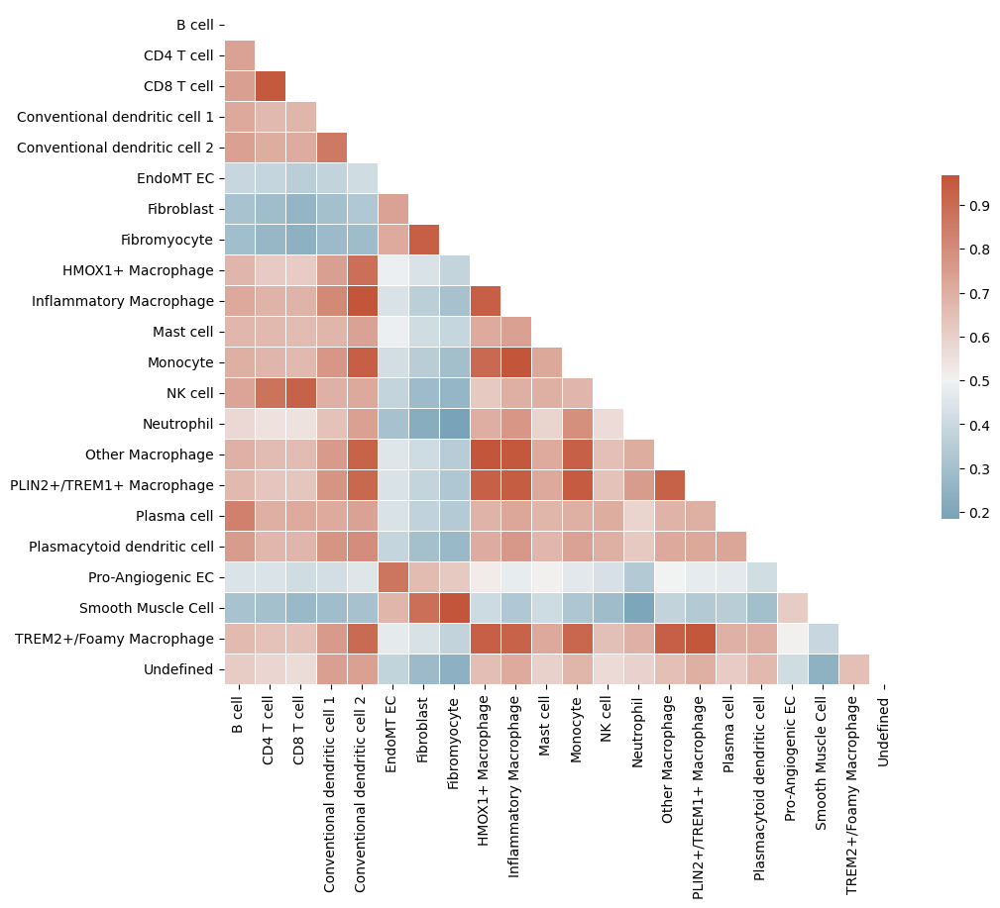

In [23]:
# Plot correlation of different cell types, using spearman rank method
corr = inf_aver.corr(method="spearman")

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, center=0.5,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [24]:
# prepare anndata for cell2location model
c2l.models.Cell2location.setup_anndata(adata=adata_visium, batch_key="sample")

map_model2wo = c2l.models.Cell2location(
    adata_visium, cell_state_df=inf_aver,
    # the expected average cell abundance: tissue-dependent hyper-prior which can be estimated from paired histology:
    N_cells_per_location=5,
    # hyperparameter controlling normalisation of within-experiment variation in RNA detection:
    detection_alpha=200
)
map_model2wo.view_anndata_setup()

Anndata setup with scvi-tools version 1.2.2.post2.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │  12   │
│         n_cells          │ 16593 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 4756  │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    ind_x     │   adata.obs['_indices']   │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories  ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │  FW104302   │          0          │
│                     │  FW104306   │          1          │
│                     │  FW104860   │          2          │
│                     │ FW106005_v2 │          3          │
│                     │  FW106006   │          4          │
│                     │  FW106008   │          5          │
│                     │  FW106010   │          6          │
│                     │  FW106012   │          7          │
│                     │  FW106014   │          8          │
│                     │  FW106016   │          9          │
│                     │  FW106018   │         10          │
│                     │  FW106022   │         11          │
└─────────────────────┴─────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [25]:
# The training is completed in another notebook
map_model2wo = c2l.models.Cell2location.load(os.environ.get("PATH_TO_MAP_MODEL2WO"), adata_visium)
adata_visium = map_model2wo.export_posterior(adata_visium, sample_kwargs={'num_samples': 1000, 'batch_size': map_model2wo.adata.n_obs})

INFO     File /home/b/buit/map_model/model.pt already downloaded                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Training:   0%|          | 0/30000 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=1` reached.


Sampling local variables, batch:   0%|          | 0/1 [00:00<?, ?it/s]

Sampling global variables, sample:   0%|          | 0/999 [00:00<?, ?it/s]

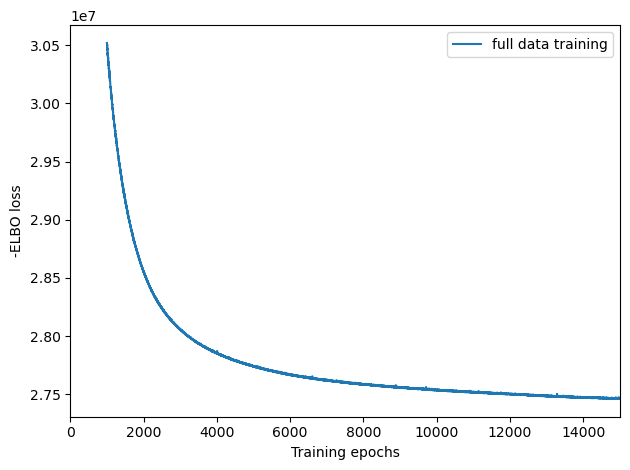

In [26]:
map_model2wo.plot_history(1000)
plt.legend(labels=['full data training']);

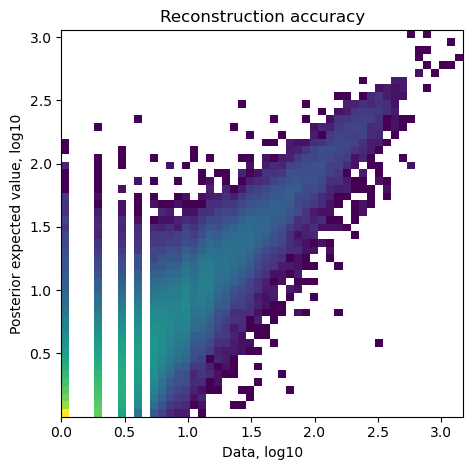

In [27]:
map_model2wo.plot_QC()

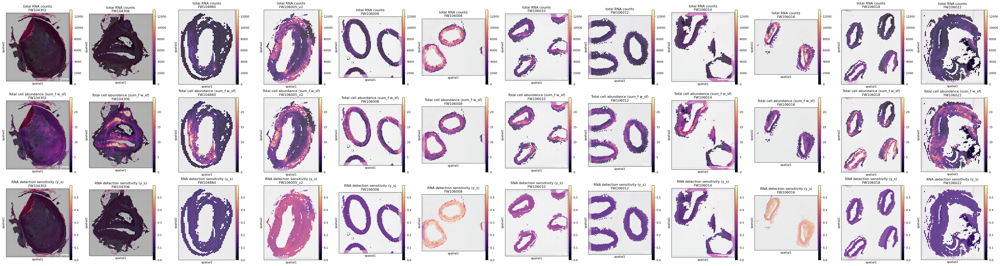

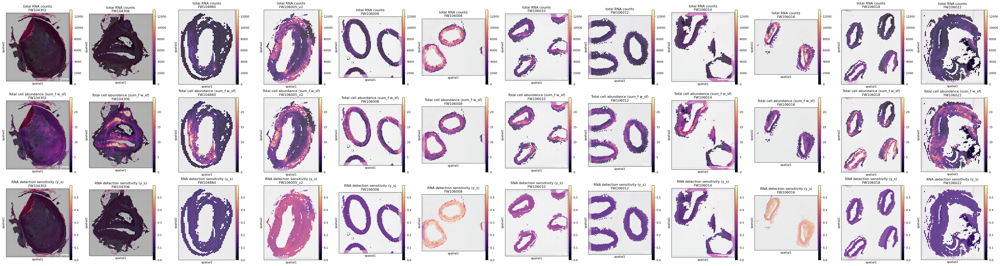

In [28]:
map_model2wo.plot_spatial_QC_across_batches()

In [29]:
adata_visium.obs[adata_visium.uns['mod']['factor_names']] = adata_visium.obsm['q05_cell_abundance_w_sf']

In [30]:
adata_visium.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,...,NK cell,Neutrophil,Other Macrophage,PLIN2+/TREM1+ Macrophage,Plasma cell,Plasmacytoid dendritic cell,Pro-Angiogenic EC,Smooth Muscle Cell,TREM2+/Foamy Macrophage,Undefined
spot_id,,,,,,,,,,,,,,,,,,,,,
FW104302_AAACAAGTATCTCCCA-1,1,50,102,FW104302,658,6.490724,789.0,6.672033,20.278834,29.277567,...,0.010113,0.028863,0.007413,0.318920,0.077732,0.029494,0.028483,0.107226,0.111522,0.005748
FW104302_AAACACCAATAACTGC-1,1,59,19,FW104302,904,6.807935,1159.0,7.056175,16.911130,25.539258,...,0.105525,0.048836,0.113959,0.036858,0.189409,0.013386,0.339066,0.644811,0.102235,0.026292
FW104302_AAACAGAGCGACTCCT-1,1,14,94,FW104302,327,5.793014,365.0,5.902633,24.109589,37.808219,...,0.005118,0.019376,0.014508,0.001427,0.041755,0.001393,0.005297,0.133933,0.000820,0.001338
FW104302_AAACAGCTTTCAGAAG-1,1,43,9,FW104302,341,5.834811,384.0,5.953243,24.218750,37.239583,...,0.004176,0.003747,0.033290,0.005955,0.019396,0.001206,0.020037,0.235626,0.006075,0.001665
FW104302_AAACAGGGTCTATATT-1,1,47,13,FW104302,304,5.720312,345.0,5.846439,26.376812,40.869565,...,0.012640,0.006911,0.014023,0.022088,0.016239,0.009027,0.013770,0.103167,0.007486,0.002544
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FW106022_TTGTCGTTCAGTTACC-1,1,22,58,FW106022,1566,7.356918,2417.0,7.790696,19.362847,27.141084,...,0.014869,0.034019,0.502189,0.004508,0.015409,0.003814,0.030262,0.118161,0.004814,0.004809
FW106022_TTGTGAGGCATGACGC-1,1,43,13,FW106022,3226,8.079308,7199.0,8.881836,25.503542,31.309904,...,0.174547,0.070697,0.073687,1.987877,0.243186,0.042701,0.288299,0.059553,1.013304,0.033971
FW106022_TTGTGGCCCTGACAGT-1,1,18,60,FW106022,416,6.033086,502.0,6.220590,27.091633,37.051793,...,0.000891,0.001006,0.003099,0.000519,0.000642,0.001427,0.001435,0.028608,0.000190,0.000439


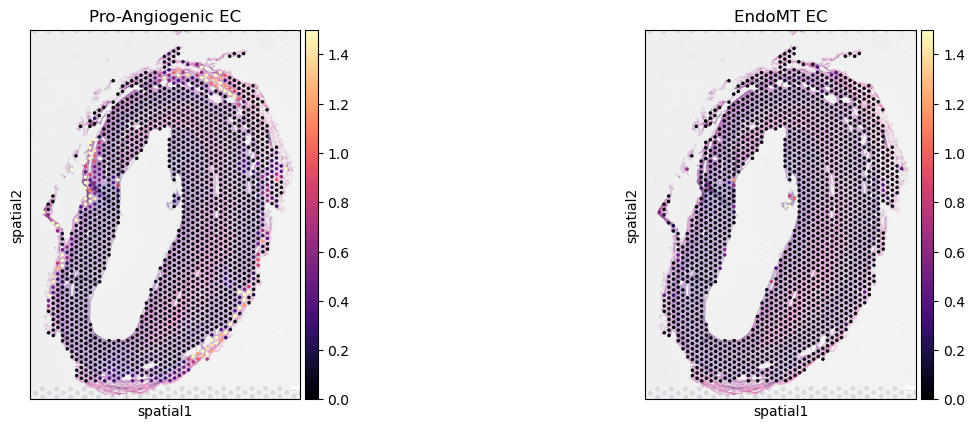

In [31]:
sc.pl.spatial(select_slide(adata_visium,'FW106005_v2'), color=['Pro-Angiogenic EC','EndoMT EC'],vmin=0, cmap='magma', vmax=1.5)

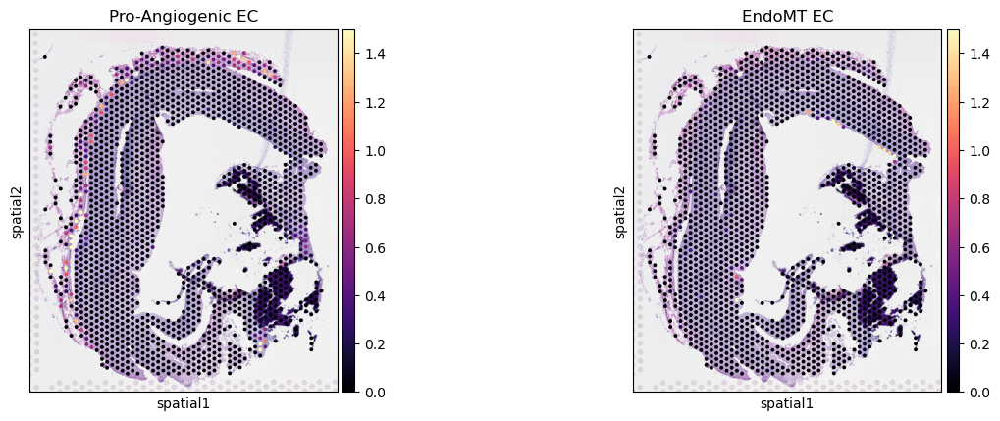

In [32]:
sc.pl.spatial(select_slide(adata_visium,'FW106022'), color=['Pro-Angiogenic EC','EndoMT EC'],vmin=0, cmap='magma', vmax=1.5)

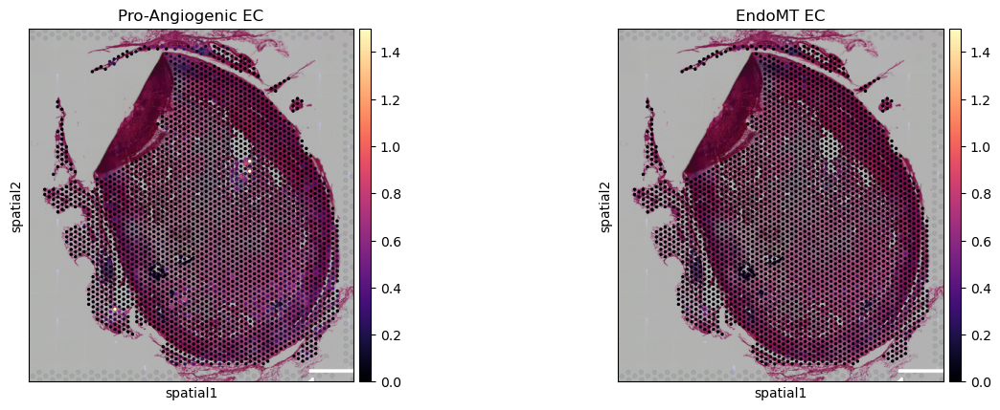

In [33]:
sc.pl.spatial(select_slide(adata_visium,'FW104302'), color=['Pro-Angiogenic EC','EndoMT EC'],vmin=0, cmap='magma', vmax=1.5)

### Downstream analysis

In [34]:
# compute KNN using the cell2location output stored in adata.obsm
sc.pp.neighbors(adata_visium, use_rep='q05_cell_abundance_w_sf',
                n_neighbors = 15)

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_visium, resolution=1.1, flavor="igraph", n_iterations=2, directed=False)

# add region as categorical variable
adata_visium.obs["region_cluster"] = adata_visium.obs["leiden"].astype("category")

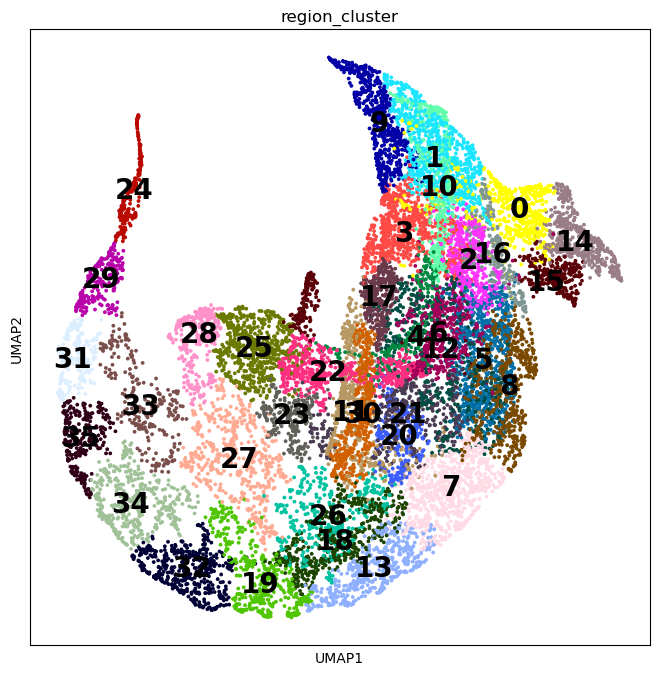

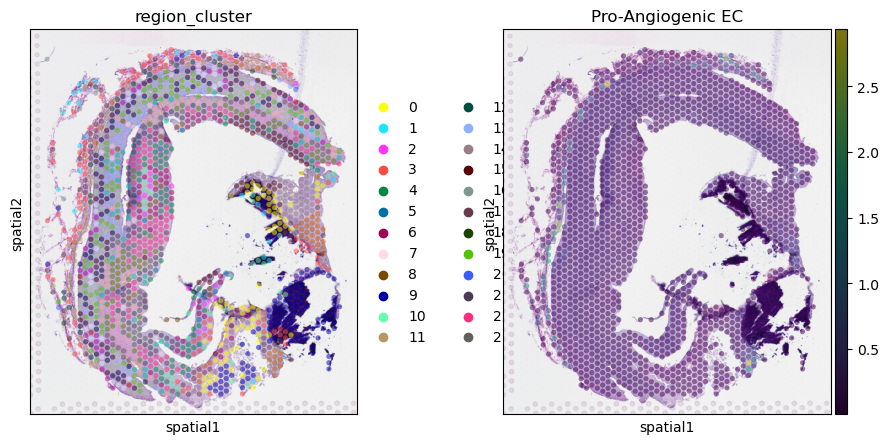

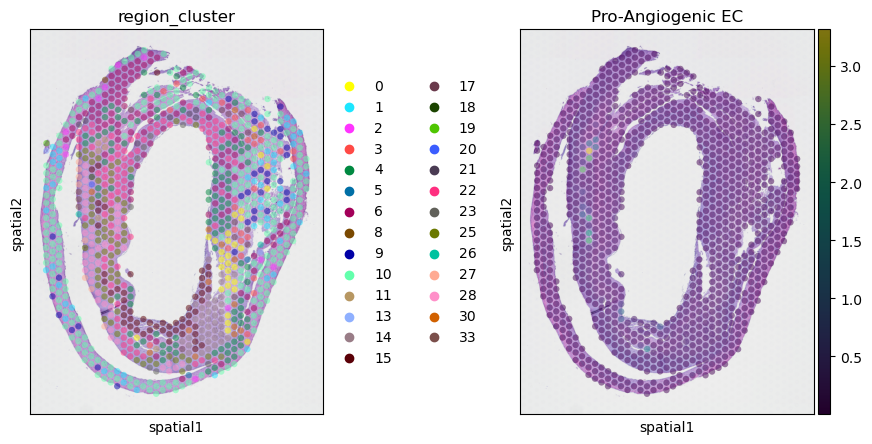

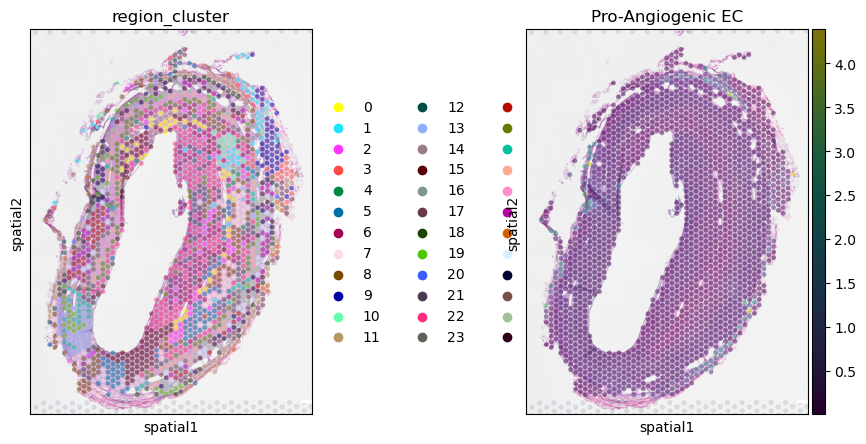

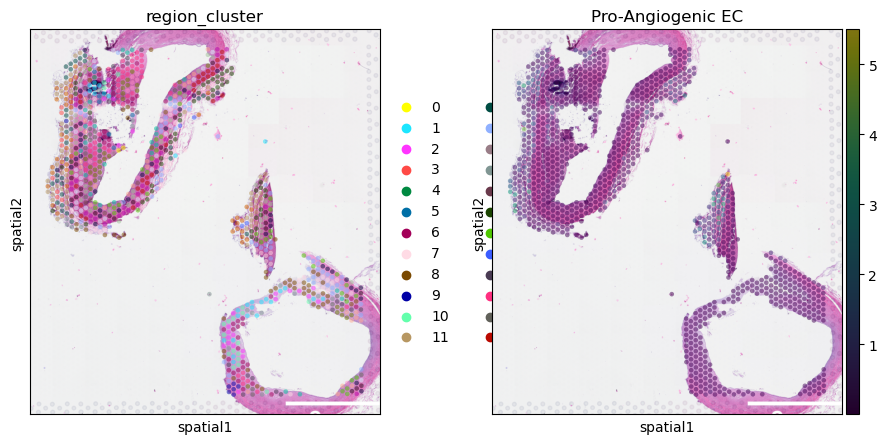

...

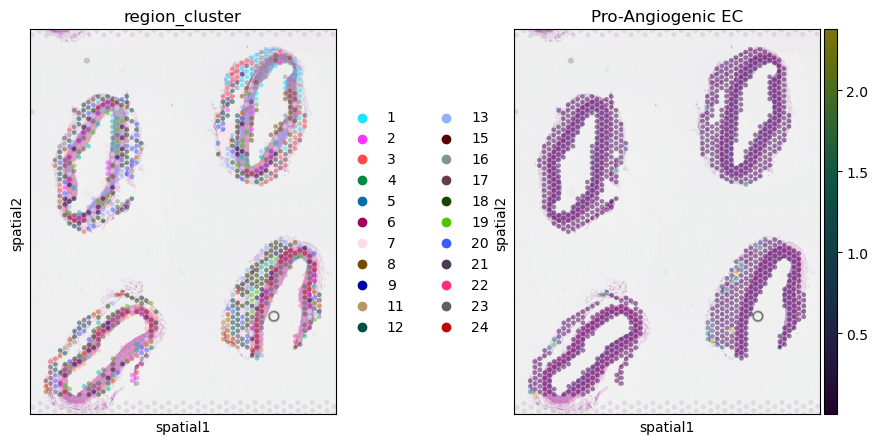

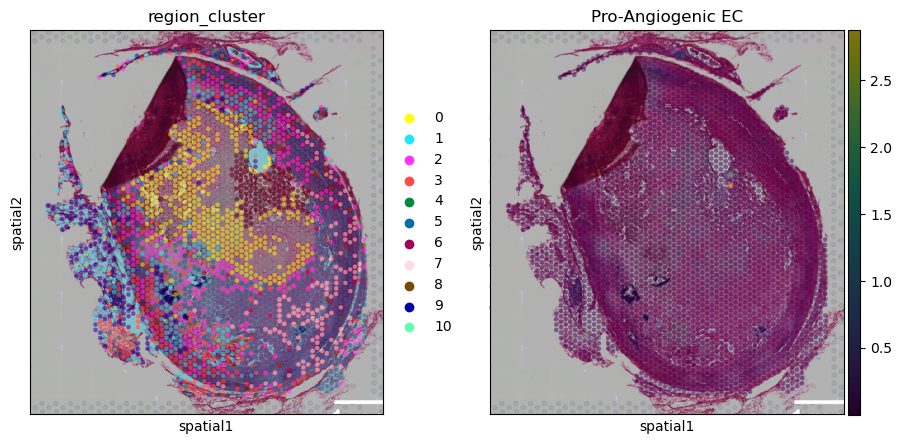

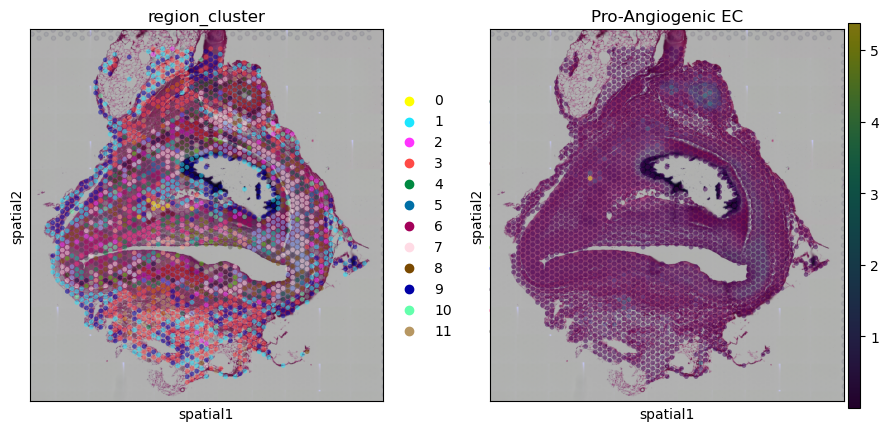

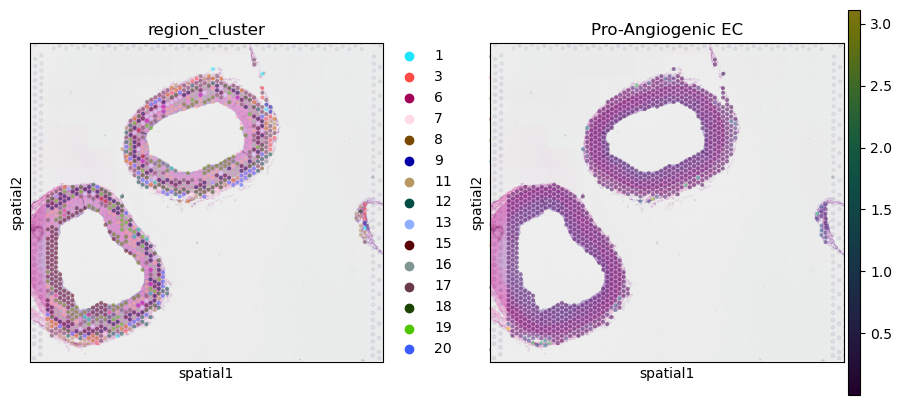

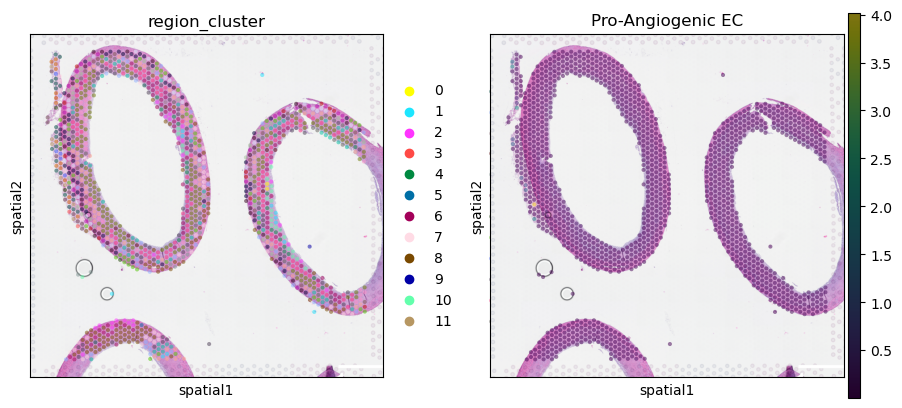

In [35]:
# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_visium, min_dist = 0.3, spread = 1)

# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [8, 8]}):
    sc.pl.umap(adata_visium, color=['region_cluster'], size=30,
               color_map = 'RdPu', ncols = 2, legend_loc='on data',
               legend_fontsize=20)

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):
    for i, s in enumerate(sorted_samples):
        slide = select_slide(adata_visium, s)
        sc.pl.spatial(slide, color=['region_cluster', 'Pro-Angiogenic EC'],
                  size=1.3, img_key='hires', alpha=0.5)